In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.statespace.sarimax import SARIMAX
from itertools import product
from sklearn.metrics import mean_absolute_error, mean_squared_error
import warnings
from statsmodels.tsa.arima.model import ARIMA
import itertools
from prophet import Prophet
from statsmodels.tsa.holtwinters import ExponentialSmoothing

C:\Users\psath\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Importing plotly failed. Interactive plots will not work.


In [2]:
# Fill categorical missing values with 'Unknown'
df = pd.read_csv('cleaned_data_dropped.csv',low_memory=False)
categorical_cols = df.select_dtypes(include=['object']).columns
print(categorical_cols)

Index(['FACILITY NAME', 'ST', 'INDUSTRY SECTOR', 'CHEMICAL',
       'CLEAN AIR ACT CHEMICAL', 'CLASSIFICATION', 'METAL', 'METAL CATEGORY',
       'CARCINOGEN', 'PBT', 'PFAS', 'UNIT OF MEASURE'],
      dtype='object')


In [3]:
# Aggregate by year (if not already aggregated)
time_series_data = df.groupby('YEAR')['OFF-SITE RELEASE TOTAL'].sum().reset_index()

# Ensure the YEAR column is a datetime type
time_series_data['YEAR'] = pd.to_datetime(time_series_data['YEAR'], format='%Y')
# Step 1: Check stationarity and transform if needed
time_series_data['OFF-SITE RELEASE TOTAL_diff'] = time_series_data['OFF-SITE RELEASE TOTAL'].diff().dropna()

# ADF test for stationarity
adf_test = adfuller(time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna())
print("ADF Statistic:", adf_test[0])
print("p-value:", adf_test[1])
outliers_detect = time_series_data.copy()
# Set YEAR as the index for time-series analysis
time_series_data.set_index('YEAR', inplace=True)

# Display the data
print(time_series_data.head())
print(time_series_data.columns)
print(outliers_detect.columns)

ADF Statistic: -2.6914185867908036
p-value: 0.07553503661219142
            OFF-SITE RELEASE TOTAL  OFF-SITE RELEASE TOTAL_diff
YEAR                                                           
2003-01-01            5.930665e+08                          NaN
2004-01-01            5.978628e+08                 4.796295e+06
2005-01-01            6.242363e+08                 2.637354e+07
2006-01-01            6.541451e+08                 2.990881e+07
2007-01-01            6.704232e+08                 1.627805e+07
Index(['OFF-SITE RELEASE TOTAL', 'OFF-SITE RELEASE TOTAL_diff'], dtype='object')
Index(['YEAR', 'OFF-SITE RELEASE TOTAL', 'OFF-SITE RELEASE TOTAL_diff'], dtype='object')


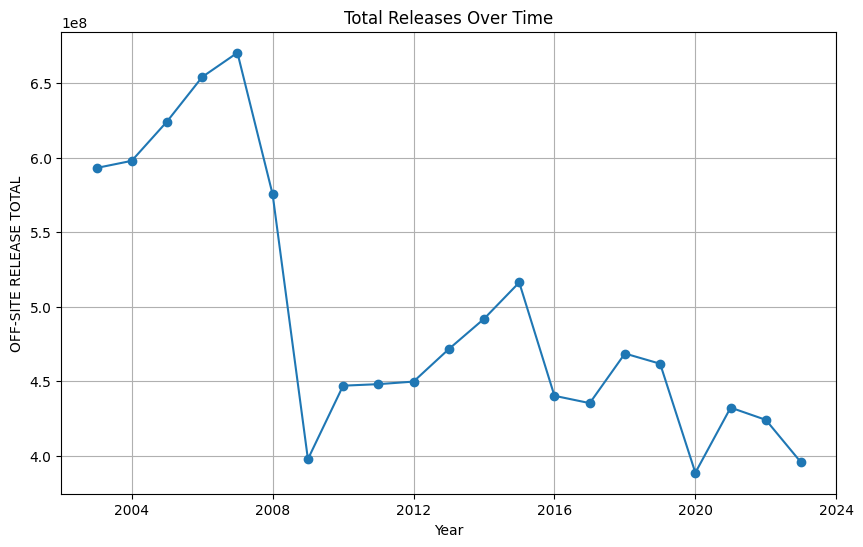

In [4]:
# Plot the time series
plt.figure(figsize=(10, 6))
plt.plot(time_series_data.index, time_series_data['OFF-SITE RELEASE TOTAL'], marker='o')
plt.title('Total Releases Over Time')
plt.xlabel('Year')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.grid()
plt.show()


In [5]:
# Calculate IQR
Q1 = time_series_data['OFF-SITE RELEASE TOTAL'].quantile(0.25)
Q3 = time_series_data['OFF-SITE RELEASE TOTAL'].quantile(0.75)
IQR = Q3 - Q1

# Identify outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
outliers = time_series_data[(time_series_data['OFF-SITE RELEASE TOTAL'] < lower_bound) | 
                            (time_series_data['OFF-SITE RELEASE TOTAL'] > upper_bound)]
print("Q1", Q1)
print("Q3", Q3)
print("IQR", IQR)
# print(time_series_data['OFF-SITE RELEASE TOTAL'])
print("Outliers based on IQR:")
print(outliers)


Q1 435235656.506373
Q3 575392132.7323743
IQR 140156476.22600132
Outliers based on IQR:
Empty DataFrame
Columns: [OFF-SITE RELEASE TOTAL, OFF-SITE RELEASE TOTAL_diff]
Index: []


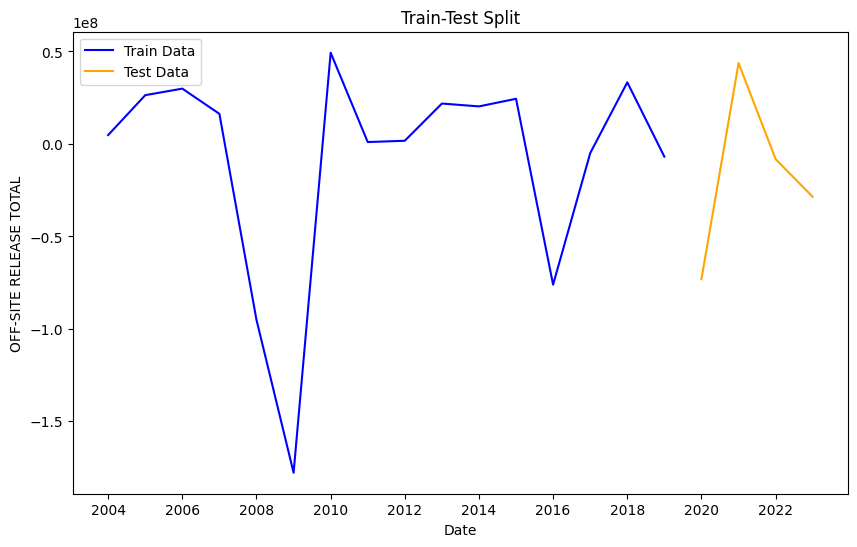

In [6]:
# Define split ratio (e.g., 80% train, 20% test)
split_ratio = 0.8
split_index = int(len(time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna()) * split_ratio)

# Split into train and test
train_data = time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna()[:split_index]
test_data = time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna()[split_index:]

# Define test_start and test_end
test_start = test_data.index[0]
test_end = test_data.index[-1]
# Extract actual values from the time series data for the test period
actual_values = time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna()[test_start:test_end]

plt.figure(figsize=(10, 6))
plt.plot(train_data, label='Train Data', color='blue')
plt.plot(test_data, label='Test Data', color='orange')
plt.xlabel('Date')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.title('Train-Test Split')
plt.legend()
plt.show()


In [7]:
def error_percentage(y_true, y_pred):
    """
    Calculate the error percentage using NumPy.

    Parameters:
    y_true (array-like): Actual values
    y_pred (array-like): Predicted values

    Returns:
    float: Error percentage
    """
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    errors = np.abs((y_true - y_pred) / y_true)
    return np.mean(errors) * 100

In [8]:

warnings.filterwarnings('ignore')

# Define parameter grid for SARIMA
p = d = q = range(0, 3)  # Non-seasonal params
P = D = Q = range(0, 2)  # Seasonal params
s = [12]  # Seasonal period (yearly data)

# Create all combinations
param_grid = list(product(p, d, q, P, D, Q, s))

# Track best parameters
best_rmse_SARIMA = float("inf")
best_maep_SARIMA = float("inf")
best_params = None

# Grid search
for params in param_grid:
    try:
        sarima_model = SARIMAX(time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna()[:-3],
                               order=(params[0], params[1], params[2]),
                               seasonal_order=(params[3], params[4], params[5], params[6]),
                               enforce_stationarity=False,
                               enforce_invertibility=False)
        results = sarima_model.fit(disp=False)
        # Predict and evaluate
        predictions = results.predict(start=test_start, end=test_end)
        rmse = np.sqrt(mean_squared_error(actual_values, predictions))
        maep = error_percentage(actual_values, predictions)
        if rmse < best_rmse_SARIMA:
            best_rmse_SARIMA = rmse
            best_params = params
            best_maep_SARIMA = maep
    except Exception as e:
        continue

p, d, q, P, D, Q, s = best_params
print(f'Best SARIMA Parameters: {best_params}')
print(f'Best RMSE: {best_rmse_SARIMA}')
print(f'Best MAEP: {best_maep_SARIMA}')


Best SARIMA Parameters: (1, 1, 2, 0, 0, 0, 12)
Best RMSE: 34178042.6536353
Best MAEP: 68.04541810653177


In [9]:
# Refit the model using the best parameters
best_model = SARIMAX(
    time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna(), 
    order=(p, d, q),        # (p, d, q)
    seasonal_order=(P, D, Q, s),  # (P, D, Q, s)
    enforce_stationarity=False, 
    enforce_invertibility=False
)

best_model_fitted = best_model.fit(disp=False)
print(best_model_fitted.summary())

# Predict on the test set
predicted_values = best_model_fitted.predict(start=test_start, end=test_end)
rmse = np.sqrt(mean_squared_error(actual_values, predicted_values))
print(f"Test RMSE: {rmse}")
print(actual_values)
print(predicted_values)



                                    SARIMAX Results                                    
Dep. Variable:     OFF-SITE RELEASE TOTAL_diff   No. Observations:                   20
Model:                        SARIMAX(1, 1, 2)   Log Likelihood                -309.070
Date:                         Wed, 20 Nov 2024   AIC                            626.140
Time:                                 15:59:14   BIC                            629.230
Sample:                             01-01-2004   HQIC                           626.298
                                  - 01-01-2023                                         
Covariance Type:                           opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8100      0.221     -3.668      0.000      -1.243      -0.377
ma.L1          0.0647      0.171      0.378      0.706     

2024-01-01   -4.449967e+06
2025-01-01    8.895070e+06
2026-01-01   -1.914443e+06
2027-01-01    6.841289e+06
2028-01-01   -2.508753e+05
Name: predicted_mean, dtype: float64
                 YEAR      FORECAST
2024-01-01 2024-12-31 -4.449967e+06
2025-01-01 2025-12-31  8.895070e+06
2026-01-01 2026-12-31 -1.914443e+06
2027-01-01 2027-12-31  6.841289e+06
2028-01-01 2028-12-31 -2.508753e+05


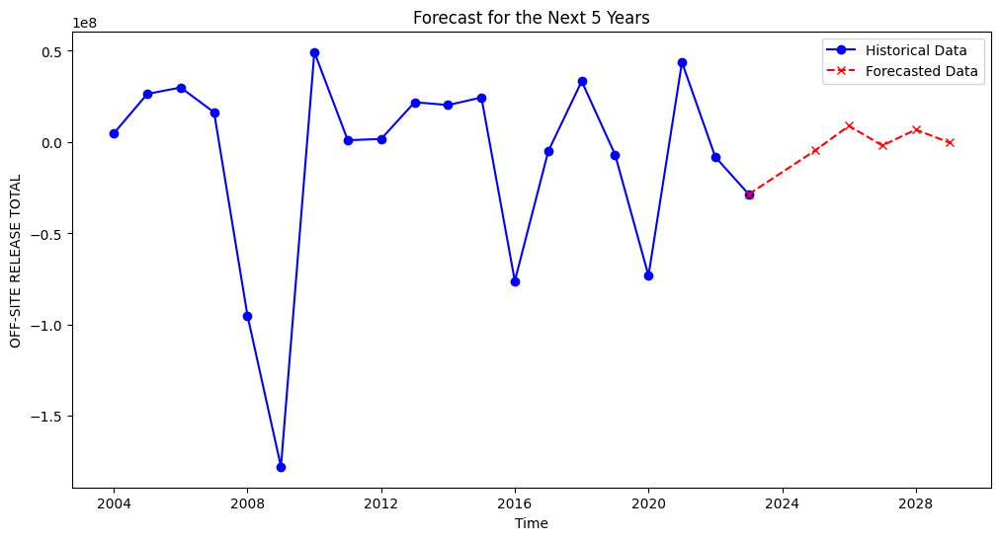

In [10]:
# Forecast for the next 5 years (60 months)
forecast_steps = 5 * 12  # 5 years
forecast = best_model_fitted.forecast(steps=forecast_steps)

# Create a date range for the forecast
forecast_index = pd.date_range(start='2024-01-01', periods=forecast_steps, freq='MS')
forecast_series = pd.Series(forecast, index=forecast_index)
forecast_series = forecast_series.dropna()
# Print the forecasted values
print(forecast_series)
historical_df = time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_series})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')
# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')
plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.legend()
plt.show()


In [11]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['OFF-SITE RELEASE TOTAL'].iloc[-1]
forecast_original_scale = forecast_series.cumsum() + last_value  
forecast_original_scale

2024-01-01    3.909953e+08
2025-01-01    3.998904e+08
2026-01-01    3.979759e+08
2027-01-01    4.048172e+08
2028-01-01    4.045663e+08
Name: predicted_mean, dtype: float64

                 YEAR      FORECAST
2024-01-01 2024-12-31  3.909953e+08
2025-01-01 2025-12-31  3.998904e+08
2026-01-01 2026-12-31  3.979759e+08
2027-01-01 2027-12-31  4.048172e+08
2028-01-01 2028-12-31  4.045663e+08


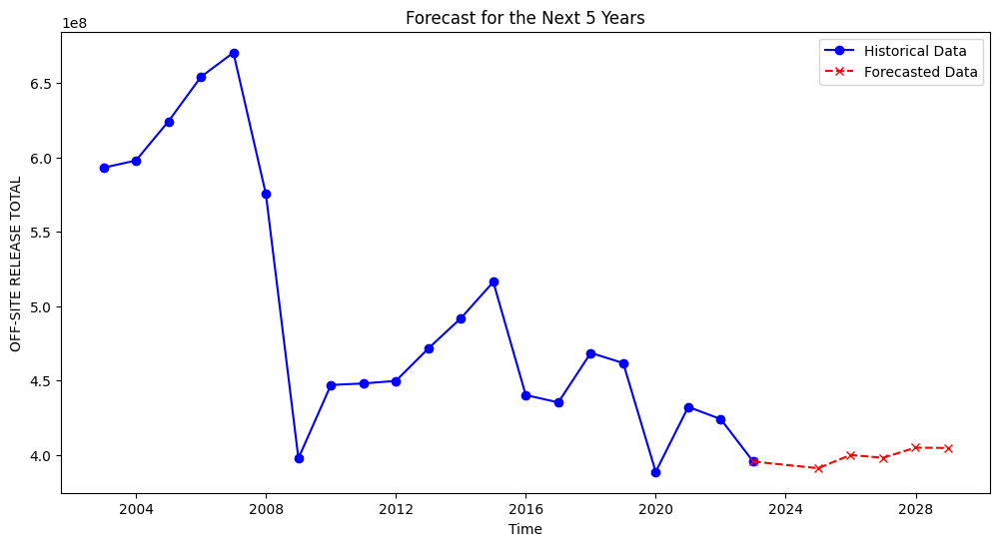

In [12]:
historical_df = time_series_data['OFF-SITE RELEASE TOTAL'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['OFF-SITE RELEASE TOTAL'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.legend()
plt.show()

In [13]:

# Define the p, d, q parameter ranges
p = d = q = range(0, 3)
pdq = list(itertools.product(p, d, q))

best_aic = float('inf')
best_pdq = None

for param in pdq:
    try:
        model = ARIMA(time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna(), order=param)
        model_fit = model.fit()
        if model_fit.aic < best_aic:
            best_aic = model_fit.aic
            best_pdq = param
    except:
        continue

print(f"Best ARIMA model order: {best_pdq} with AIC: {best_aic}")


Best ARIMA model order: (0, 2, 2) with AIC: 708.9740847002303


In [14]:
# Define the parameter grid for ARIMA (p, d, q)
p = d = q = range(0, 3)
pdq = list(itertools.product(p, d, q))

best_rmse_ARIMA = float('inf')
best_pdq = None

for param in pdq:
    try:
        model = ARIMA(time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna()[:-4], order=param)
        model_fit = model.fit()

        # Predict on the train set (or test set if available)
        predicted_values = model_fit.predict(start=test_start, end=test_end)

        # Calculate RMSE
        rmse = np.sqrt(mean_squared_error(actual_values, predicted_values))
        # print(rmse)
        # Update best model if RMSE is better
        if rmse < best_rmse_ARIMA:
            best_rmse_ARIMA = rmse
            best_pdq = param
    except Exception as e:
        print(f"Error with parameters {param}: {e}")
        continue

print(f"Best ARIMA model order: {best_pdq} with RMSE: {best_rmse_ARIMA}")


Best ARIMA model order: (1, 0, 2) with RMSE: 37034530.172899656


In [15]:
# Fit the model with the best parameters
best_model = ARIMA(time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna(), order=best_pdq)
best_model_fit = best_model.fit()

# Print the model summary
print(best_model_fit.summary())


                                    SARIMAX Results                                    
Dep. Variable:     OFF-SITE RELEASE TOTAL_diff   No. Observations:                   20
Model:                          ARIMA(1, 0, 2)   Log Likelihood                -385.751
Date:                         Wed, 20 Nov 2024   AIC                            781.502
Time:                                 15:59:36   BIC                            786.481
Sample:                             01-01-2004   HQIC                           782.474
                                  - 01-01-2023                                         
Covariance Type:                           opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const      -9.881e+06   1.14e-08  -8.66e+14      0.000   -9.88e+06   -9.88e+06
ar.L1          0.2389      0.208      1.148      0.251     

2024-01-01   -9.019731e+06
2025-01-01   -1.043207e+07
2026-01-01   -1.001271e+07
2027-01-01   -9.912516e+06
2028-01-01   -9.888577e+06
Freq: YS-JAN, Name: predicted_mean, dtype: float64
                 YEAR      FORECAST
2024-01-01 2024-12-31 -9.019731e+06
2025-01-01 2025-12-31 -1.043207e+07
2026-01-01 2026-12-31 -1.001271e+07
2027-01-01 2027-12-31 -9.912516e+06
2028-01-01 2028-12-31 -9.888577e+06


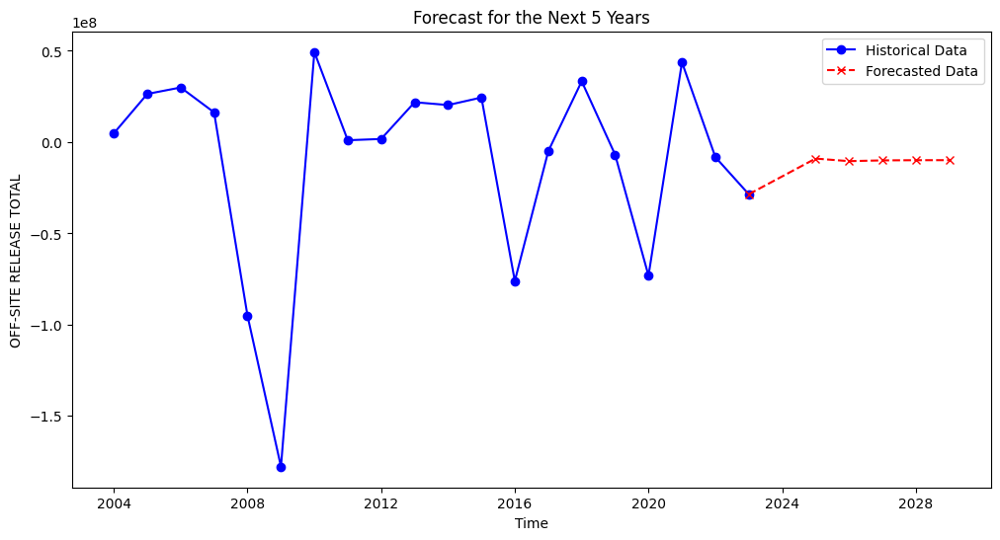

In [16]:
# Fit the ARIMA model with the best parameters (best_pdq)
model = ARIMA(time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna(), order=best_pdq)  # Use the best (p, d, q) found during tuning
model_fit = model.fit()

forecast = model_fit.forecast(steps=5)
print(forecast)

historical_df = time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast})
print(forecast_df)
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))


# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.legend()
plt.show()


In [17]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['OFF-SITE RELEASE TOTAL'].iloc[-1]
forecast_original_scale = forecast.cumsum() + last_value
forecast_original_scale

2024-01-01    3.864255e+08
2025-01-01    3.759934e+08
2026-01-01    3.659807e+08
2027-01-01    3.560682e+08
2028-01-01    3.461796e+08
Freq: YS-JAN, Name: predicted_mean, dtype: float64

                 YEAR      FORECAST
2024-01-01 2024-12-31  3.864255e+08
2025-01-01 2025-12-31  3.759934e+08
2026-01-01 2026-12-31  3.659807e+08
2027-01-01 2027-12-31  3.560682e+08
2028-01-01 2028-12-31  3.461796e+08


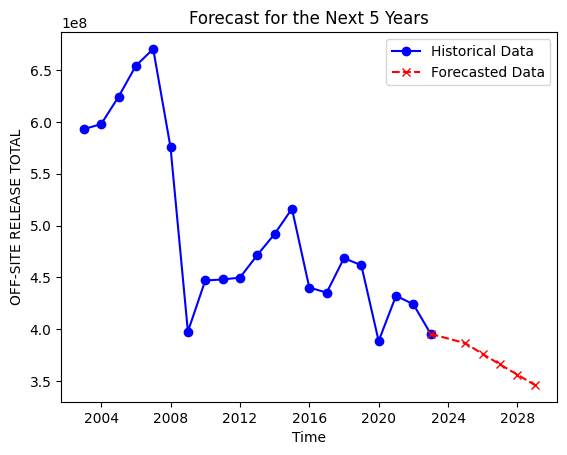

In [18]:
historical_df = time_series_data['OFF-SITE RELEASE TOTAL'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['OFF-SITE RELEASE TOTAL'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.legend()
plt.show()

In [19]:
# Rename columns for Prophet
prophet_data = outliers_detect.rename(columns={'YEAR': 'ds', 'OFF-SITE RELEASE TOTAL': 'y'})
# Fit the model
model = Prophet()
model.fit(prophet_data)

# Generate predictions
forecast = model.predict(prophet_data)

# Residuals
prophet_data['residuals'] = prophet_data['y'] - forecast['yhat']

# Highlight outliers
outliers = prophet_data[prophet_data['residuals'].abs() > 3 * prophet_data['residuals'].std()]
print("Outliers detected by Prophet:")
print(outliers)
 

15:59:37 - cmdstanpy - INFO - Chain [1] start processing
15:59:37 - cmdstanpy - INFO - Chain [1] done processing


Outliers detected by Prophet:
Empty DataFrame
Columns: [ds, y, OFF-SITE RELEASE TOTAL_diff, residuals]
Index: []


In [20]:
# Hyperparameter tuning for Prophet
best_rmse_prophet = float('inf')
best_prophet_params = None

# Hyperparameters for Prophet
changepoint_scales = [0.01, 0.1, 0.5]
seasonality_modes = ['additive', 'multiplicative']

# Assuming you have your time_series_data with 'OFF-SITE RELEASE TOTAL'
# and you are working with the original time series (not differenced)
df_prophet = time_series_data[['OFF-SITE RELEASE TOTAL_diff']].reset_index()
df_prophet.columns = ['ds', 'y']
# print(df_prophet[:-5])

for changepoint in changepoint_scales:
    for seasonality in seasonality_modes:
        try:
            # Create and fit the Prophet model
            model = Prophet(yearly_seasonality=True,changepoint_prior_scale=changepoint, seasonality_mode=seasonality)
            model.fit(df_prophet[:-5])

            # Forecast for the next 5 years (60 months)
            future = model.make_future_dataframe(periods=6, freq='Y',include_history=False)  # Forecasting for the next 5 years
            forecast = model.predict(future)
            # print(forecast_values)
            # Forecasted values
            forecast_values = forecast['yhat'][1:].values  # For the next 60 months
            print(forecast_values)

            # Compare with actual values (if available, for RMSE calculation)
            # You would compare these forecasted values with your test set if available
            # If no actual future values exist, this step can be skipped
            # Example assuming actual values for comparison (otherwise, remove this part):
            actual_values = time_series_data['OFF-SITE RELEASE TOTAL_diff'][-5:]  # Adjust this as needed
            # print("--------------",(actual_values, forecast_values))
            rmse = np.sqrt(mean_squared_error(actual_values, forecast_values))
            # print("--------------")

            # Update best RMSE and parameters
            if rmse < best_rmse_prophet:
                best_rmse_prophet = rmse
                best_prophet_params = (changepoint, seasonality)

        except Exception as e:
            print(f"Error with Prophet params (changepoint={changepoint}, seasonality={seasonality}): {e}")
            continue

print(f"Best Prophet model with RMSE: {best_rmse_prophet} and parameters: {best_prophet_params}")


15:59:37 - cmdstanpy - INFO - Chain [1] start processing
15:59:37 - cmdstanpy - INFO - Chain [1] done processing
15:59:37 - cmdstanpy - INFO - Chain [1] start processing
15:59:37 - cmdstanpy - INFO - Chain [1] done processing


[-38968454.23731452 -15531242.71202334 -21770952.96254615
 -28771546.83315118 -36522065.27176451]


15:59:37 - cmdstanpy - INFO - Chain [1] start processing


[-1235168.28961776  -545862.55460554   127737.87539388   806899.52673407
  1490661.07142154]


15:59:37 - cmdstanpy - INFO - Chain [1] done processing
15:59:38 - cmdstanpy - INFO - Chain [1] start processing
15:59:38 - cmdstanpy - INFO - Chain [1] done processing


[-38989164.44343111 -15548475.41328808 -21789898.18683554
 -28792227.30042067 -36544502.05783664]
[-1465976.9806742   -702672.42513665    41433.3643427    791814.25009884
  1547400.27370482]


15:59:38 - cmdstanpy - INFO - Chain [1] start processing
15:59:38 - cmdstanpy - INFO - Chain [1] done processing
15:59:38 - cmdstanpy - INFO - Chain [1] start processing


[-39000396.21297359 -15556920.71815218 -21799205.04645351
 -28802436.90673428 -36555654.38524379]


15:59:38 - cmdstanpy - INFO - Chain [1] done processing


[24861124.44702009 33725918.38484804 42255142.97333501 50710897.24654977
 59075445.00987566]
Best Prophet model with RMSE: 40423578.9189255 and parameters: (0.1, 'multiplicative')


15:59:38 - cmdstanpy - INFO - Chain [1] start processing
15:59:39 - cmdstanpy - INFO - Chain [1] done processing


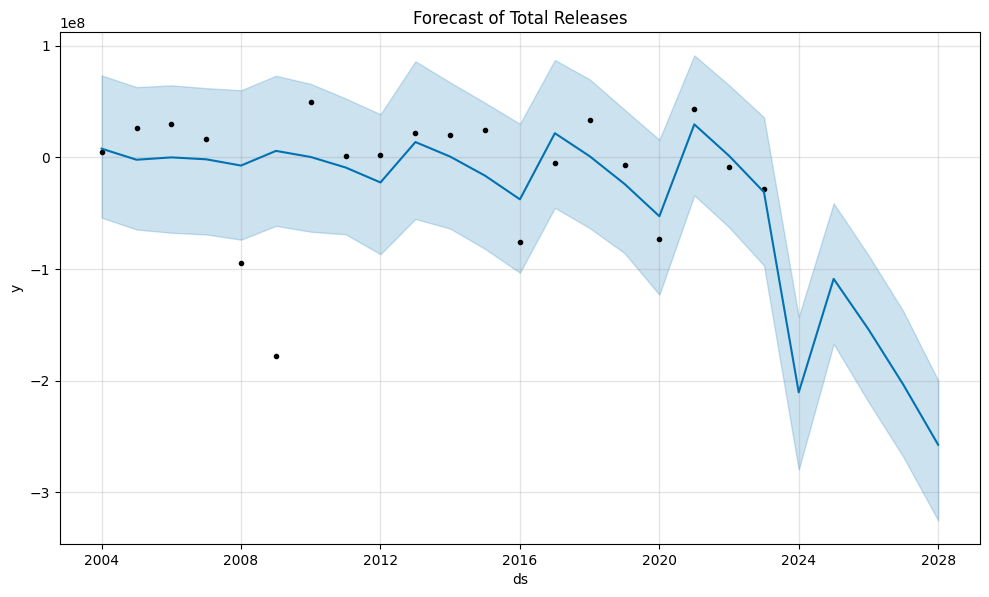

,ds,yhat,yhat_lower,yhat_upper
20,2023-12-31,-2.105242e+08,-2.798466e+08,-1.429469e+08
21,2024-12-31,-1.088403e+08,-1.671914e+08,-4.113025e+07
22,2025-12-31,-1.541069e+08,-2.191306e+08,-8.769884e+07
23,2026-12-31,-2.036570e+08,-2.683742e+08,-1.378799e+08
24,2027-12-31,-2.574823e+08,-3.253122e+08,-1.998541e+08


In [21]:
time_series_prophet_data = time_series_data['OFF-SITE RELEASE TOTAL_diff'].dropna().copy()
# Prepare data for Prophet
prophet_data = time_series_prophet_data.reset_index()
prophet_data.columns = ['ds', 'y']  # Prophet requires 'ds' for date and 'y' for the target

# Initialize and fit the Prophet model
model = Prophet(changepoint_prior_scale=best_prophet_params[0], seasonality_mode=best_prophet_params[1],yearly_seasonality=True)
model.fit(prophet_data)

# Create a DataFrame for future years
future = model.make_future_dataframe(periods=5, freq='Y')  # Forecasting for the next 5 years
forecast = model.predict(future)

# Plot the forecast
model.plot(forecast)
plt.title('Forecast of Total Releases')
plt.show()

# Display forecasted values
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail(5)


In [22]:
# Assuming 'time_series_data' has 'OFF-SITE RELEASE TOTAL' column with yearly data
df_hw = time_series_data[['OFF-SITE RELEASE TOTAL']][:-5]
trend_options = ['add', 'mul']
# Try fitting with no seasonality and additive seasonality
best_rmse_hw = float('inf')
best_hw_params = None

for trend in trend_options:
    for seasonal in [None, 'mul','add']:  # 'None' means no seasonality, 'add' means additive seasonality
        try:
            # Fit the Holt-Winters Exponential Smoothing model
            if seasonal:
                model = ExponentialSmoothing(df_hw, trend=trend, seasonal=seasonal,seasonal_periods=1)  # Yearly data, seasonal periods=1
            else:
                model = ExponentialSmoothing(df_hw, trend=trend, seasonal=None)  # No seasonality
            
            model_fit = model.fit()

            # Forecast for the next 5 years (5 values)
            forecast_steps = 5  # Forecasting 5 years ahead
            forecast_values = model_fit.forecast(forecast_steps)
            # print(forecast_values)
            # If actual future values are available, calculate RMSE
            # Assuming actual values exist in the future for comparison
            actual_values = time_series_data['OFF-SITE RELEASE TOTAL'].values[-5:]  # Adjust this if you have real data
            rmse = np.sqrt(mean_squared_error(actual_values, forecast_values))

            # Update best RMSE and parameters
            if rmse < best_rmse_hw:
                best_rmse_hw = rmse
                best_hw_params = (trend, seasonal)

        except Exception as e:
            print(f"Error with Exponential Smoothing params (seasonal={seasonal}): {e}")
            continue

print(f"Best Holt-Winters model with RMSE: {best_rmse_hw} and parameters: {best_hw_params}")


Error with Exponential Smoothing params (seasonal=mul): seasonal_periods must be larger than 1.
Error with Exponential Smoothing params (seasonal=add): seasonal_periods must be larger than 1.
Error with Exponential Smoothing params (seasonal=mul): seasonal_periods must be larger than 1.
Error with Exponential Smoothing params (seasonal=add): seasonal_periods must be larger than 1.
Best Holt-Winters model with RMSE: 23973282.43991283 and parameters: ('mul', None)


In [23]:
# Fit Holt-Winters model (using additive trend and seasonality)
model = ExponentialSmoothing(time_series_data['OFF-SITE RELEASE TOTAL'], trend=best_hw_params[0], seasonal=best_hw_params[1]).fit()

# Forecast the next 12 periods (e.g., months)
forecast = model.forecast(steps=5)
print(forecast)

2024-01-01    3.811492e+08
2025-01-01    3.673090e+08
2026-01-01    3.539714e+08
2027-01-01    3.411181e+08
2028-01-01    3.287315e+08
Freq: YS-JAN, dtype: float64


                 YEAR      FORECAST
2024-01-01 2024-12-31  3.811492e+08
2025-01-01 2025-12-31  3.673090e+08
2026-01-01 2026-12-31  3.539714e+08
2027-01-01 2027-12-31  3.411181e+08
2028-01-01 2028-12-31  3.287315e+08


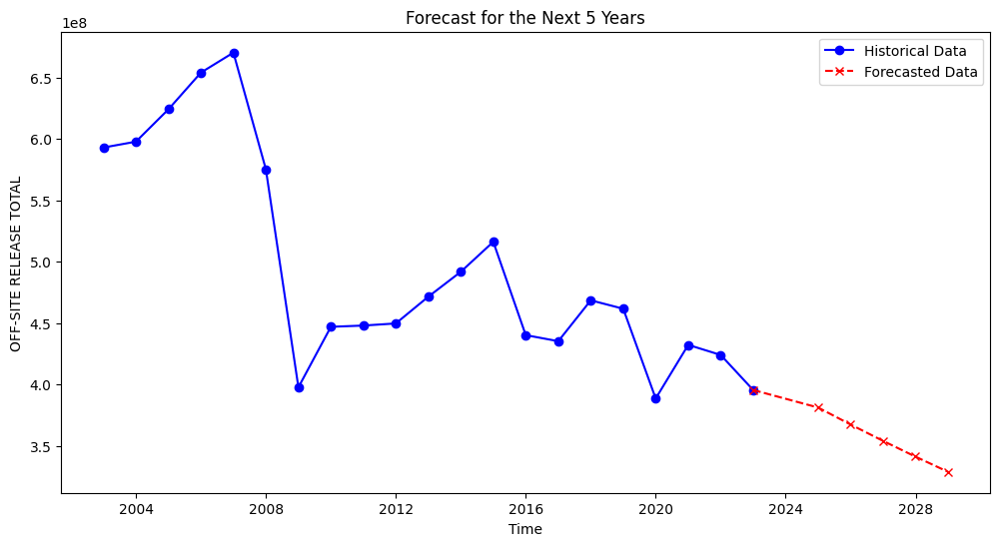

In [24]:
historical_df = time_series_data['OFF-SITE RELEASE TOTAL'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['OFF-SITE RELEASE TOTAL'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast})
print(forecast_df)
plt.figure(figsize=(12, 6))

# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.legend()
plt.show()

In [25]:
pip install xgboost

Defaulting to user installation because normal site-packages is not writeableNote: you may need to restart the kernel to use updated packages.



In [26]:
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Prepare lagged features
def create_lag_features(data, lag=1):
    df = pd.DataFrame(data)
    for i in range(1, lag + 1):
        df[f'lag_{i}'] = df[0].shift(i)
    df = df.dropna()
    return df

# Lag settings
lag = 3  # Use the last 3 values to predict the next one
data_lagged = create_lag_features(time_series_data['OFF-SITE RELEASE TOTAL_diff'].values, lag)
X = data_lagged.iloc[:, 1:].values
y = data_lagged.iloc[:, 0].values

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print(X_test)
print(y_test)
# Hyperparameter tuning for XGBoost
best_rmse_xgb = float('inf')
best_xgb_params = None

# Hyperparameter grid
learning_rates = [0.01, 0.1, 0.2]
max_depths = [3, 5, 7, 9, 11, 13, 15]
n_estimators = [50, 100, 200, 400]

for lr in learning_rates:
    for depth in max_depths:
        for n in n_estimators:
            try:
                # Train XGBoost model
                model = XGBRegressor(learning_rate=lr, max_depth=depth, n_estimators=n, objective='reg:squarederror')
                model.fit(X_train, y_train)

                # Predict on test set
                y_pred = model.predict(X_test)
                rmse = np.sqrt(mean_squared_error(y_test, y_pred))

                # Update best RMSE and parameters
                if rmse < best_rmse_xgb:
                    best_rmse_xgb = rmse
                    best_xgb_params = (lr, depth, n)

            except Exception as e:
                print(f"Error with XGBoost params (lr={lr}, depth={depth}, n_estimators={n}): {e}")
                continue

print(f"Best XGBoost model with RMSE: {best_rmse_xgb} and parameters: {best_xgb_params}")



[[ 2.99088130e+07  2.63735390e+07  4.79629481e+06]
 [ 1.62780453e+07  2.99088130e+07  2.63735390e+07]
 [ 1.01882157e+06  4.93139358e+07 -1.77753394e+08]
 [ 4.36949840e+07 -7.31453781e+07 -6.86381325e+06]]
[ 16278045.28953528 -95031050.40821385   1715734.71496075
  -8221851.58388752]
Best XGBoost model with RMSE: 47397700.38303573 and parameters: (0.01, 3, 50)


In [27]:

# Forecast future values
last_lag = time_series_data['OFF-SITE RELEASE TOTAL_diff'].values[-lag:]  # Last 'lag' values
model = XGBRegressor(learning_rate=best_xgb_params[0], max_depth=best_xgb_params[1], n_estimators=best_xgb_params[2], objective='reg:squarederror')
model.fit(X_train, y_train)
# print(last_lag)
future_forecasts = []
for _ in range(5):  # Forecast 5 future values
    input_data = last_lag[-lag:].reshape(1, -1)
    # print(input_data)
    prediction = model.predict(input_data)[0]
    future_forecasts.append(prediction)
    last_lag = np.append(last_lag, prediction)

print("Forecasted values for next 5 years:", future_forecasts)

Forecasted values for next 5 years: [np.float32(-10379781.0), np.float32(2738647.8), np.float32(2738647.8), np.float32(2738647.8), np.float32(2738647.8)]


In [28]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['OFF-SITE RELEASE TOTAL'].iloc[-1]
forecast_original_scale = np.array(future_forecasts).cumsum() + last_value  
forecast_original_scale

array([3.85065466e+08, 3.87804114e+08, 3.90542762e+08, 3.93281410e+08,
       3.96020058e+08])

        YEAR      FORECAST
0 2024-12-31  3.850655e+08
1 2025-12-31  3.878041e+08
2 2026-12-31  3.905428e+08
3 2027-12-31  3.932814e+08
4 2028-12-31  3.960201e+08


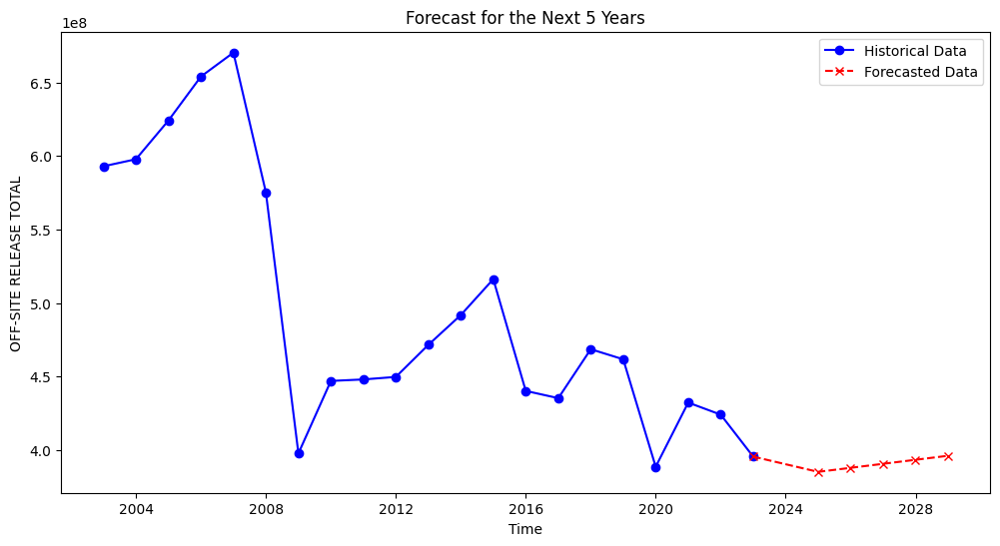

In [29]:
historical_df = time_series_data['OFF-SITE RELEASE TOTAL'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['OFF-SITE RELEASE TOTAL'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.legend()
plt.show()

In [30]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

grid_search = GridSearchCV(
    estimator=XGBRegressor(objective="reg:squarederror"),
    param_grid=param_grid,
    scoring='neg_mean_squared_error',
    cv=3,
    verbose=1
)

grid_search.fit(X_train, y_train)
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 108 candidates, totalling 324 fits
Best Parameters: {'colsample_bytree': 0.8, 'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 50, 'subsample': 0.8}


In [31]:
time_series_data['OFF-SITE RELEASE TOTAL']

YEAR
2003-01-01    5.930665e+08
2004-01-01    5.978628e+08
2005-01-01    6.242363e+08
2006-01-01    6.541451e+08
2007-01-01    6.704232e+08
2008-01-01    5.753921e+08
2009-01-01    3.976387e+08
2010-01-01    4.469527e+08
2011-01-01    4.479715e+08
2012-01-01    4.496872e+08
2013-01-01    4.715263e+08
2014-01-01    4.918198e+08
2015-01-01    5.162329e+08
2016-01-01    4.401642e+08
2017-01-01    4.352357e+08
2018-01-01    4.685398e+08
2019-01-01    4.616760e+08
2020-01-01    3.885307e+08
2021-01-01    4.322256e+08
2022-01-01    4.240038e+08
2023-01-01    3.954452e+08
Name: OFF-SITE RELEASE TOTAL, dtype: float64

In [32]:
from sklearn.model_selection import GridSearchCV
from lightgbm import LGBMRegressor

# Define the parameter grid
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7],
    'num_leaves': [20, 31, 50],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0]
}

# Grid search for hyperparameter tuning
grid_search = GridSearchCV(
    estimator=LGBMRegressor(random_state=42),
    param_grid=param_grid,
    scoring='neg_mean_squared_error',
    cv=3,  # 3-fold cross-validation
    verbose=1
)

grid_search.fit(X_train, y_train)
print("Best Parameters:", grid_search.best_params_)


Fitting 3 folds for each of 324 candidates, totalling 972 fits
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 8, number of used features: 0
[LightGBM] [Info] Start training from score -2994288.367188
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning]

In [33]:
from lightgbm import LGBMRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import pandas as pd
import numpy as np

# Prepare lagged features
def create_lag_features(data, lag=1):
    """
    Create lagged features for a time series dataset.
    """
    df = pd.DataFrame(data)
    for i in range(1, lag + 1):
        df[f'lag_{i}'] = df[0].shift(i)
    df = df.dropna()
    return df

# Lag settings
lag = 3  # Use the last 3 values to predict the next one
data_lagged = create_lag_features(time_series_data['OFF-SITE RELEASE TOTAL_diff'].values, lag)
X = data_lagged.iloc[:, 1:].values  # Lagged features
y = data_lagged.iloc[:, 0].values  # Target variable

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Hyperparameter tuning for LightGBM
best_rmse_lgb = float('inf')
best_maep_lgb = float('inf')
best_lgb_params = None
best_y_test = best_y_pred = 0

# Hyperparameter grid
learning_rates = [0.01, 0.1, 0.2]
max_depths = [3, 5, 7, 9]
n_estimators = [50, 100, 200]
num_leaves = [20, 31, 50, 100, 150, 200]
subsample = [0.8, 1.0]
colsample_bytree = [0.8, 1.0]

for lr in learning_rates:
    for depth in max_depths:
        for n in n_estimators:
            for leaves in num_leaves:
                for sample in subsample:
                    for colsample in colsample_bytree:
                        try:
                            # Train LightGBM model
                            model = LGBMRegressor(
                                learning_rate=lr, 
                                max_depth=depth, 
                                n_estimators=n, 
                                objective='regression',
                                num_leaves = leaves,
                                subsample=sample,
                                colsample_bytree = colsample,
                                random_state=42
                            )
                            model.fit(X_train, y_train)

                            # Predict on test set
                            y_pred = model.predict(X_test)
                            rmse = np.sqrt(mean_squared_error(y_test, y_pred))
                            maep = error_percentage(y_test, y_pred)

                            # Update best RMSE and parameters
                            if rmse < best_rmse_lgb:
                                best_rmse_lgb = rmse
                                best_maep_lgb = maep
                                best_y_test = y_test
                                best_y_pred = y_pred
                                best_lgb_params = (lr, depth, n, leaves, sample, colsample)

                        except Exception as e:
                            print(f"Error with LightGBM params (lr={lr}, depth={depth}, n_estimators={n}): {e}")
                            continue

print(f"Best LightGBM model with RMSE: {best_rmse_lgb}, MAEP: {best_maep_lgb} and parameters: {best_lgb_params}")


[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 13, number of used features: 0
[LightGBM] [Info] Start training from score -13341596.995192
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet 

In [34]:
# Forecast future values
last_lag = time_series_data['OFF-SITE RELEASE TOTAL_diff'].values[-lag:]  # Last 'lag' values
model = LGBMRegressor(learning_rate=best_lgb_params[0], max_depth=best_lgb_params[1], n_estimators=best_lgb_params[2], 
                      objective='regression', num_leaves = best_lgb_params[3], subsample=best_lgb_params[4],
                      colsample_bytree = best_lgb_params[5], random_state=42)
model.fit(X_train, y_train)
# print(last_lag)
future_forecasts = []
for _ in range(5):  # Forecast 5 future values
    input_data = last_lag[-lag:].reshape(1, -1)
    # print(input_data)
    prediction = model.predict(input_data)[0]
    future_forecasts.append(prediction)
    last_lag = np.append(last_lag, prediction)

print("Forecasted values for next 5 years:", future_forecasts)

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 13, number of used features: 0
[LightGBM] [Info] Start training from score -13341596.995192
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet 

In [35]:
# Inverse the differencing to return to the original scale
last_value = time_series_data['OFF-SITE RELEASE TOTAL'].iloc[-1]
forecast_original_scale = np.array(future_forecasts).cumsum() + last_value  
forecast_original_scale

array([3.82103650e+08, 3.68762053e+08, 3.55420456e+08, 3.42078859e+08,
       3.28737262e+08])

        YEAR      FORECAST
0 2024-12-31  3.821037e+08
1 2025-12-31  3.687621e+08
2 2026-12-31  3.554205e+08
3 2027-12-31  3.420789e+08
4 2028-12-31  3.287373e+08


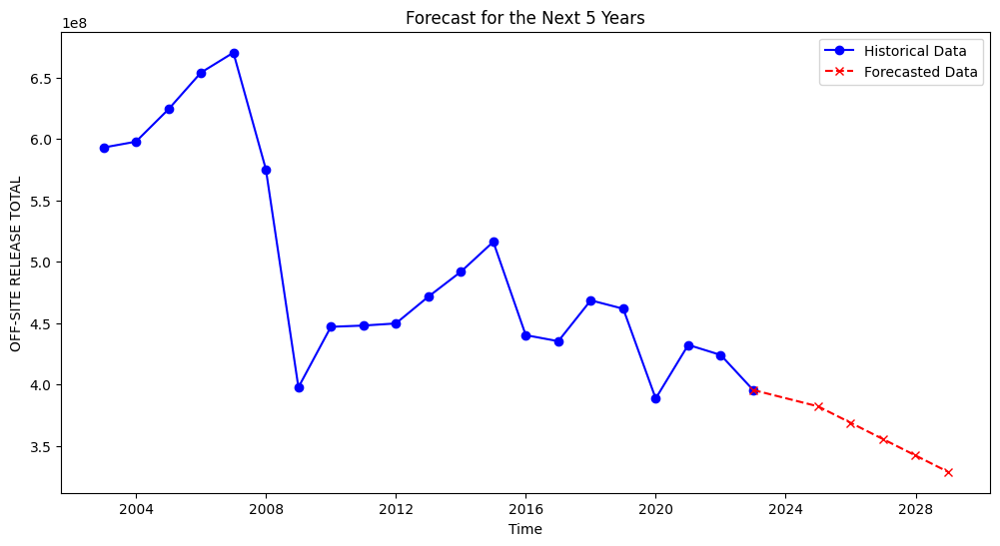

In [36]:
historical_df = time_series_data['OFF-SITE RELEASE TOTAL'].dropna().reset_index()
historical_df.columns = ['YEAR', 'ACTUAL']
# Display forecasted values
future_years = pd.date_range(start=time_series_data['OFF-SITE RELEASE TOTAL'].dropna().index[-1] + pd.DateOffset(years=1), periods=5, freq='Y')
forecast_df = pd.DataFrame({'YEAR': future_years, 'FORECAST': forecast_original_scale})
print(forecast_df)

plt.figure(figsize=(12, 6))
# Plot historical data
plt.plot(historical_df['YEAR'], historical_df['ACTUAL'], label='Historical Data', marker='o', color='blue')

# Plot forecasted data
plt.plot([historical_df['YEAR'].iloc[-1]] + forecast_df['YEAR'].tolist(), 
         [historical_df['ACTUAL'].iloc[-1]] + forecast_df['FORECAST'].tolist(), 
         label='Forecasted Data', marker='x', linestyle='--', color='red')

plt.title('Forecast for the Next 5 Years')
plt.xlabel('Time')
plt.ylabel('OFF-SITE RELEASE TOTAL')
plt.legend()
plt.show()

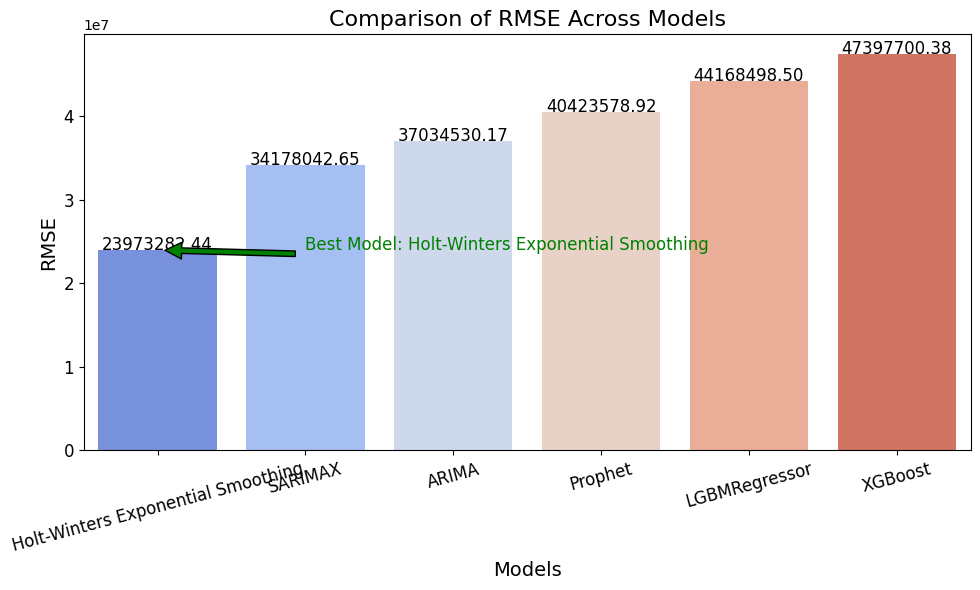

In [37]:
# RMSE values for each model
models = ['SARIMAX', 'ARIMA', 'Holt-Winters Exponential Smoothing', 'Prophet', 'XGBoost', 'LGBMRegressor']
rmse_values = [best_rmse_SARIMA, best_rmse_ARIMA, best_rmse_hw, best_rmse_prophet, best_rmse_xgb, best_rmse_lgb]  # Replace with your actual RMSE values

# Convert to a dictionary for better readability
model_rmse = dict(zip(models, rmse_values))

# Sort models by RMSE (optional)
sorted_model_rmse = {k: v for k, v in sorted(model_rmse.items(), key=lambda item: item[1])}

# Visualization
plt.figure(figsize=(10, 6))
sns.barplot(x=list(sorted_model_rmse.keys()), y=list(sorted_model_rmse.values()), palette="coolwarm")

# Add RMSE values on top of the bars
for i, v in enumerate(sorted_model_rmse.values()):
    plt.text(i, v + 0.2, f"{v:.2f}", ha='center', fontsize=12, color='black')

# Customize the plot
plt.title('Comparison of RMSE Across Models', fontsize=16)
plt.ylabel('RMSE', fontsize=14)
plt.xlabel('Models', fontsize=14)
plt.xticks(rotation=15, fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

# Highlight the best model (lowest RMSE)
best_model = min(sorted_model_rmse, key=sorted_model_rmse.get)
plt.annotate(f'Best Model: {best_model}', 
             xy=(list(sorted_model_rmse.keys()).index(best_model), sorted_model_rmse[best_model]), 
             xytext=(1, sorted_model_rmse[best_model] + 1), 
             arrowprops=dict(facecolor='green', shrink=0.05), fontsize=12, color='green')

plt.show()
